<a href="https://colab.research.google.com/github/mhlaghari/SmartPPE/blob/main/SmartPPE_Final_V1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
%%capture
!pip install super-gradients
!pip install imutils
!pip install roboflow
!pip install pytube --upgrade

In [1]:
from super_gradients.training import Trainer
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import coco_detection_yolo_format_train, coco_detection_yolo_format_val

The console stream is logged into /root/sg_logs/console.log


[2023-12-07 11:45:22] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it
[2023-12-07 11:45:22] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-12-07 11:45:22] INFO - utils.py - NumExpr defaulting to 2 threads.
[2023-12-07 11:45:35] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-12-07 11:45:35] WARNING - export.py - Failed to import pytorch_quantization
[2023-12-07 11:45:35] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization


In [2]:
from IPython.display import clear_output

In [3]:
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback

In [4]:
from super_gradients.training import models

In [5]:
CHECKPOINT_DIR = 'checkpoints2'
trainer = Trainer(experiment_name='ppe_yolonas_run2',
                  ckpt_root_dir=CHECKPOINT_DIR)

In [6]:
# !pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="JGDFc3OWeDyH42leWLHy")
project = rf.workspace("objet-detect-yolov5").project("eep_detection-u9bbd")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to EEP_Detection-1 in yolov5pytorch::  83%|████████▎ | 5405/6482 [00:00<00:00, 8780.83it/s]

In [7]:
dataset_params = {
    'data_dir': '/content/EEP_Detection-1',
    'train_images_dir': 'train/images',
    'train_labels_dir': 'train/labels',
    'val_images_dir': 'valid/images',
    'val_labels_dir': 'valid/labels',
    'test_images_dir': 'test/images',
    'test_labels_dir': 'test/labels',
    'classes': ['Protective Helmet',
                'Shield',
                'Jacket',
                'Dust Mask',
                'Eye Wear',
                'Glove',
                'Protective Boots']
}

In [8]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':2
    }
)

val_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':2
    }
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':2
    }
)
clear_output()

Indexing dataset annotations: 100%|██████████| 324/324 [00:00<00:00, 3187.03it/s]


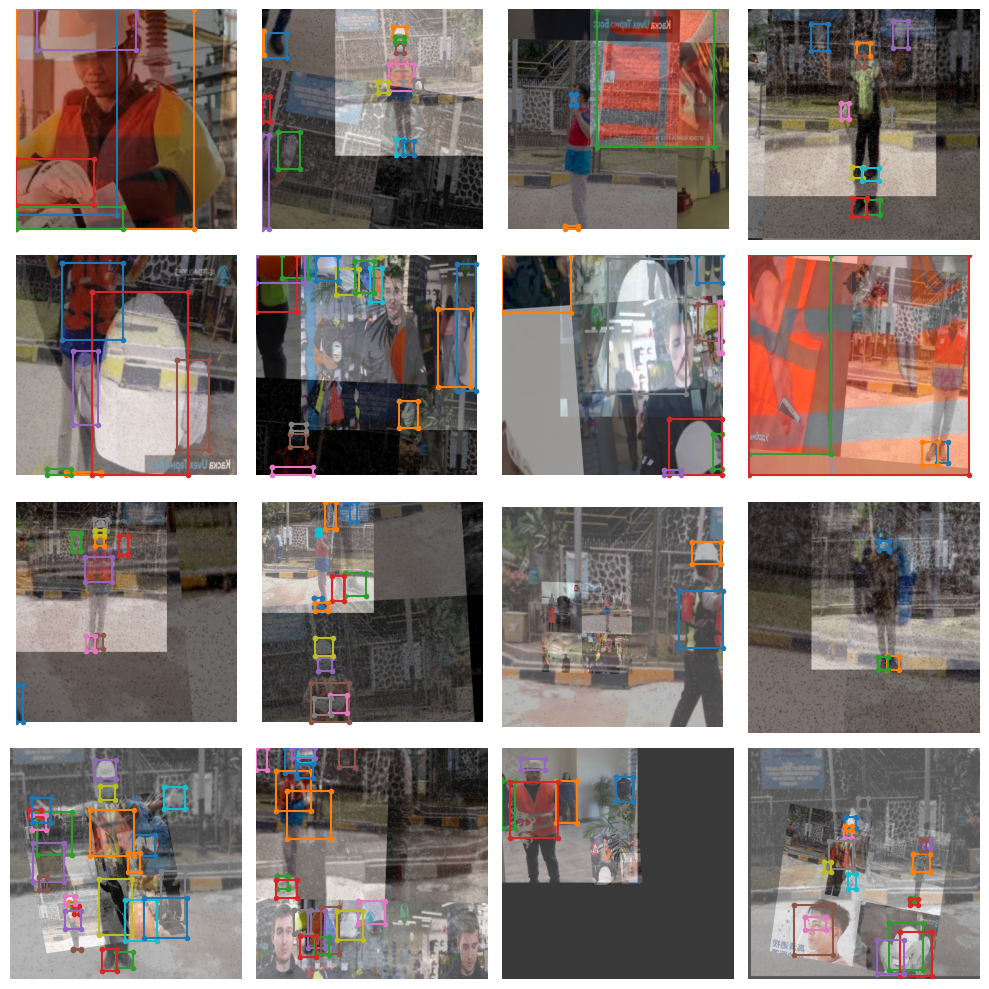

In [9]:
train_data.dataset.plot()

In [10]:
model = models.get('yolo_nas_s',
                   num_classes=len(dataset_params['classes']),
                   pretrained_weights='coco')

[2023-12-07 11:45:51] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_s_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_s_coco.pth
100%|██████████| 73.1M/73.1M [00:02<00:00, 30.4MB/s]
[2023-12-07 11:45:54] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_s


In [11]:
# train_params = {
#     'silent_mode': True,
#     'average_best_models': True,
#     'warmup_mode': 'LinearEpochLRWarmup',
#     'warmup_initial_lr': 1e-6,
#     'lr_warmup_epochs': 3,
#     'initial_lr': 5e-4,
#     'lr_mode': 'cosine',
#     'cosine_final_lr_ratio': 0.1,
#     'optimizer': 'Adam',
#     'optimizier_params': {'weight_decay': 0.0001},
#     'zero_weight_decay_on_bias_and_bn': True,
#     'ema': True,
#     'ema_params': {'decay': 0.9, 'decay_type': 'threshold'},
#     'max_epochs': 10,
#     'mixed_precision': True,
#     'loss': PPYoloELoss(
#         use_static_assigner=False,
#         num_classes=len(dataset_params['classes']),
#         reg_max=16
#     ),
#     "valid_metrics_list": [
#         DetectionMetrics_050(
#             score_thres=0.1,
#             top_k_predictions=300,
#             num_cls=len(dataset_params['classes']),
#             normalize_targets=True,
#             post_prediction_callback=PPYoloEPostPredictionCallback(
#                 score_threshold=0.01,
#                 nms_top_k=1000,
#                 max_predictions=300,
#                 nms_threshold=0.7
#             )
#         )
#     ],
#     'metrics_to_watch': 'mAP@0.50'

# }

In [12]:
train_params = {
    # ENABLING SILENT MODE
    'silent_mode': True,
    "average_best_models":True,
    "warmup_mode": 'LinearEpochLRWarmup',
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    # ONLY TRAINING FOR 10 EPOCHS FOR THIS EXAMPLE NOTEBOOK
    "max_epochs": 15,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        # NOTE: num_classes needs to be defined here
        num_classes=len(dataset_params['classes']),
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            # NOTE: num_classes needs to be defined here
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}

In [13]:
trainer.train(model=model,
              training_params=train_params,
              train_loader=train_data,
              valid_loader=val_data)

[2023-12-07 11:46:03] INFO - sg_trainer.py - Starting a new run with `run_id=RUN_20231207_114603_011783`
[2023-12-07 11:46:03] INFO - sg_trainer.py - Checkpoints directory: checkpoints2/ppe_yolonas_run2/RUN_20231207_114603_011783
[2023-12-07 11:46:03] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}


The console stream is now moved to checkpoints2/ppe_yolonas_run2/RUN_20231207_114603_011783/console_Dec07_11_46_03.txt


[2023-12-07 11:46:06] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Full dataset size:            2264       (len(train_set))
    - Batch size per GPU:           16         (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             16         (num_gpus * batch_size)
    - Effective Batch size:         16         (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         141        (len(train_loader))
    - Gradient updates per epoch:   141        (len(train_loader) / batch_accumulate)
    - Model: YoloNAS_S  (19.02M parameters, 19.02M optimized)
    - Learning Rates and Weight Decays:
      - default: (19.02M parameters). LR: 0.0005 (19.02M parameters) WD: 0.0, (42.15K parameters), WD: 0.0001, (18.98M parameters)

[2023-12-07 11:46:06] WARNING - sg_trainer.py - Could not set prepr

In [14]:
best_model = models.get('yolo_nas_s',
                        num_classes=len(dataset_params['classes']),
                        checkpoint_path="/content/ckpt_best.pth")

[2023-12-07 12:35:01] INFO - base_sg_logger.py - [CLEANUP] - Successfully stopped system monitoring process


In [15]:
trainer.test(model=best_model,
            test_loader=test_data,
            test_metrics_list=DetectionMetrics_050(score_thres=0.1,
                                                   top_k_predictions=300,
                                                   num_cls=len(dataset_params['classes']),
                                                   normalize_targets=True,
                                                   post_prediction_callback=PPYoloEPostPredictionCallback(score_threshold=0.01,
                                                                                                          nms_top_k=1000,
                                                                                                          max_predictions=300,
                                                                                                          nms_threshold=0.7)
                                                  ))


[2023-12-07 12:35:04] INFO - checkpoint_utils.py - Successfully loaded model weights from /content/ckpt_best.pth EMA checkpoint.
Testing: 100%|██████████| 21/21 [00:10<00:00,  2.07it/s]


{'PPYoloELoss/loss_cls': 0.7438316,
 'PPYoloELoss/loss_iou': 0.39962852,
 'PPYoloELoss/loss_dfl': 0.44633904,
 'PPYoloELoss/loss': 1.589799,
 'Precision@0.50': 0.07596922665834427,
 'Recall@0.50': 0.9839315414428711,
 'mAP@0.50': 0.817897617816925,
 'F1@0.50': 0.1377832591533661}

[2023-12-07 12:35:55] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


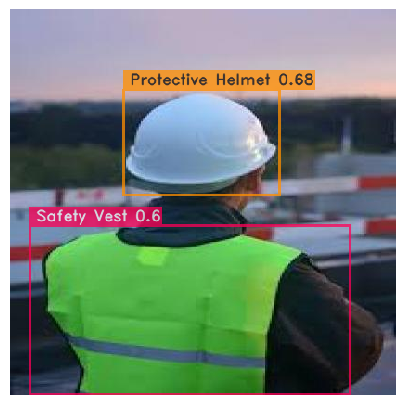

In [17]:
img_url = '/content/EEP_Detection-1/valid/images/85_jpg.rf.b48e9a461f2a216e48c8ba8a7dd3bcd3.jpg'
best_model.predict(img_url).show()

[2023-12-07 12:48:29] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


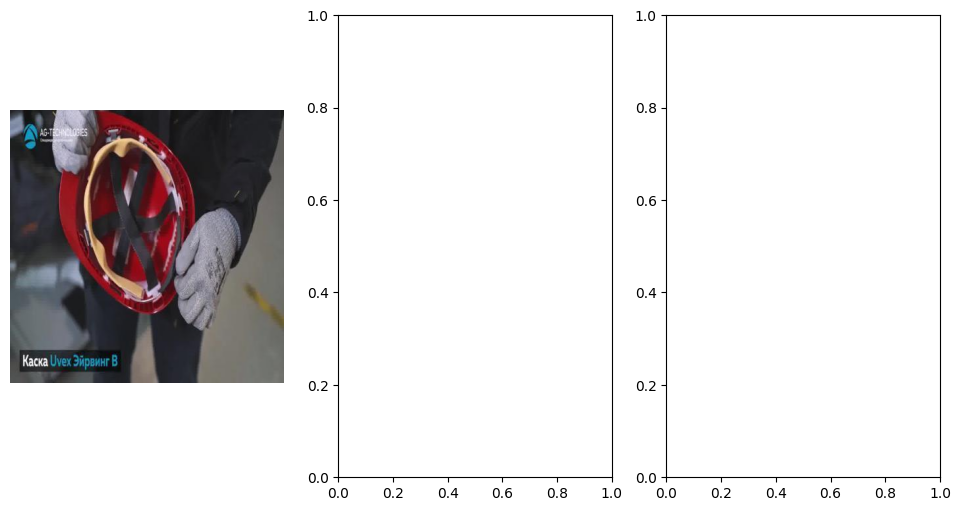

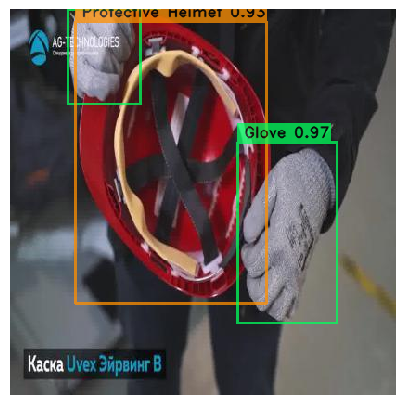

[2023-12-07 12:48:30] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


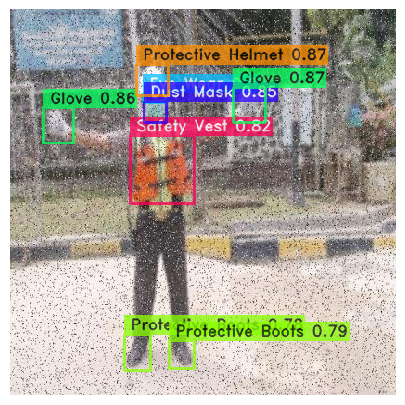

[2023-12-07 12:48:31] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


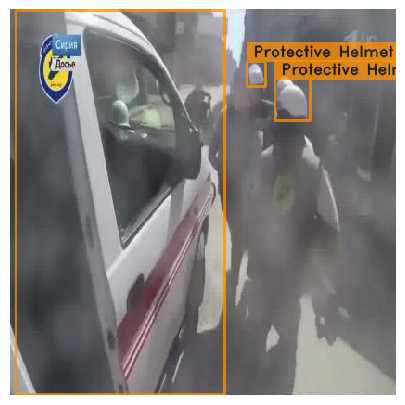

In [27]:
import os
import random
import matplotlib.pyplot as plt
from PIL import Image

# Set the path to the directory containing your images
images_directory = '/content/EEP_Detection-1/valid/images/'

# List all image files in the directory
image_files = [f for f in os.listdir(images_directory) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Choose 10 random images
random_images = random.sample(image_files, 3)

# Display the selected images along with predictions
fig, axes = plt.subplots(1, 3, figsize=(12, 6))

for i, ax in enumerate(axes.flat):
    image_file = random_images[i]
    img_path = os.path.join(images_directory, image_file)

    # Load and display the image
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis('off')

    # Make a prediction using best_model
    prediction = best_model.predict(img_path).show()

    # Display the prediction as a title
    ax.set_title(f'Prediction: {prediction}')




In [18]:
input_video_path = f"/content/PPE_Part1.mp4"
output_video_path = "detections1.mp4"

In [19]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [24]:

best_model.to(device).predict(input_video_path).save(output_video_path)

Processing Video: 100%|██████████| 310/310 [00:25<00:00, 12.21it/s]


In [28]:
!rm '/content/result_compressed.mp4'

NotImplementedError: ignored

In [30]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections1.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width = 400 controls>
  <source src="%s" type="video/mp4"
</video>
""" % data_url)

In [31]:
input_video_path = f"/content/PPE_Part2.mp4"
output_video_path = "detections2.mp4"

In [32]:
best_model.to(device).predict(input_video_path).save(output_video_path)

Processing Video:  96%|█████████▌| 255/267 [00:17<00:00, 30.26it/s]

In [34]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed2.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width = 400 controls>
  <source src="%s" type="video/mp4"
</video>
""" % data_url)

In [35]:
input_video_path = f"/content/Construction Work _ Construction Site _ Building _ Free Stock Footage _Video#380.mp4"
output_video_path = "detections3.mp4"

In [36]:
best_model.to(device).predict(input_video_path).save(output_video_path)

Processing Video:  99%|█████████▉| 1918/1940 [00:33<00:00, 76.89it/s]

In [37]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections3.mp4'

# Compressed video path
compressed_path = "/content/result_compressed3.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width = 400 controls>
  <source src="%s" type="video/mp4"
</video>
""" % data_url)

In [38]:
input_video_path = f"/content/videoplayback.mp4"
output_video_path = "detections4.mp4"

In [39]:
best_model.to(device).predict(input_video_path).save(output_video_path)

Processing Video: 100%|██████████| 607/607 [00:11<00:00, 52.20it/s]


In [41]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections4.mp4'

# Compressed video path
compressed_path = "/content/result_compressed4.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width = 400 controls>
  <source src="%s" type="video/mp4"
</video>
""" % data_url)